# Hao_PBMC Level 1 ACT annotation result
JobID: 20241016151119X0DLSWHM2388AC  
http://xteam.xbio.top/ACT/ResultAction.action?jobID=20241016151119X0DLSWHM2388AC

In [1]:
from pathlib import Path

# Get the current working directory as a Path object
current_path = Path.cwd()
home_folder = 'evan_home'

# Traverse up the directory tree until you find the target folder
for parent in [current_path] + list(current_path.parents):
    if parent.name == home_folder:
        home_path = parent
        break
else:
    raise ValueError(f"Folder '{home_folder}' not found in the current working directory.")

print("Home Path:", home_path)
source_code_dir = home_path / 'Source_code'
dataset_dir = home_path / 'Dataset'


Home Path: c:\Users\evanlee\Documents\Bmi_NAS_evan\evan_home


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
import os

In [3]:
annot = pd.read_csv('ACT_Annotation_L1.txt', index_col=0, sep='\t')

In [4]:
annot = annot.rename(columns={'whg.overlap': 'canonical.marker.overlap', 'gsea.overlap': 'gsea.DEG.overlap'})
annot.head(12)

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap
Order,,,,,,,,,
1,B,B cell,3.598612e-56,1.428824e-54,7.807473e-07,11/169,12/264,"CD79A,MS4A1,IGKC,BANK1,IGLC2,RALGPS2,CD79B,CD7...","CD79A,MS4A1,IGKC,BANK1,IGLC2,RALGPS2,CD79B,CD7..."
2,B,Plasma cell,4.722135e-31,8.865780e-34,5.742145e-02,7/64,7/333,"CD79A,MS4A1,IGKC,IGLC2,CD79B,IGHM,PTPRC","CD79A,IGKC,IGLC2,CD79B,CD74,IGHM,B2M"
3,B,Granulocyte,7.493112e-26,9.689368e-28,NaN,10/69,2/40,"CD79A,MS4A1,IGKC,BANK1,IGLC2,CD79B,CD74,IGHM,H...","HLA-DRA,FTH1"
4,B,Memory B cell,8.672851e-20,1.137160e-22,3.119369e-01,6/39,8/44,"MS4A1,BANK1,CD74,IGHM,HLA-DRA,S100A4","CD79A,MS4A1,IGKC,BANK1,RALGPS2,CD74,IGHM,HLA-DRA"
5,B,Pro-B cell,1.803002e-15,1.947465e-18,5.653710e-01,6/17,5/73,"CD79A,MS4A1,CD79B,CD74,IGHM,HLA-DRA","CD79A,CD79B,CD74,IGHM,HLA-DRA"
6,B,Naive B cell,2.887010e-13,5.066515e-16,4.648649e-01,2/22,8/66,"MS4A1,IGHM","CD79A,MS4A1,IGKC,BANK1,CD79B,CD74,IGHM,HLA-DRA"
7,B,Immature B cell,3.946254e-13,7.355853e-15,5.064655e-02,2/5,8/119,"CD79A,MS4A1","CD79A,MS4A1,BANK1,RALGPS2,CD79B,CD74,IGHM,HLA-DRA"
8,B,Plasmacytoid dendritic cell,2.888271e-11,1.120450e-12,NaN,7/93,5/295,"CD79A,MS4A1,IGKC,IGLC2,CD74,HLA-DRA,PTPRC","IGKC,CD74,IGHM,HLA-DRA,MYL12A"
9,B,Macrophage,7.836084e-10,5.645901e-12,2.320329e-01,6/281,9/653,"CD74,HLA-DRA,B2M,PTPRC,FTH1,S100A4","CD74,HLA-DRA,TMSB4X,B2M,PTPRC,FTH1,ACTB,S100A4..."


In [4]:
annot['canonical.marker.overlap'] = annot['canonical.marker.overlap'].str.split(',').fillna('')
annot['gsea.DEG.overlap'] = annot['gsea.DEG.overlap'].str.split(',').fillna('')

In [5]:
annot['union'] = annot.apply(lambda row: list(set(row['canonical.marker.overlap']) | set(row['gsea.DEG.overlap'])), axis=1)
annot.head(12)

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,B,B cell,3.598612e-56,1.428824e-54,7.807473e-07,11/169,12/264,"[CD79A, MS4A1, IGKC, BANK1, IGLC2, RALGPS2, CD...","[CD79A, MS4A1, IGKC, BANK1, IGLC2, RALGPS2, CD...","[PTPRC, B2M, MALAT1, BANK1, IGKC, IGLC2, CD79A..."
2,B,Plasma cell,4.722135e-31,8.865780e-34,5.742145e-02,7/64,7/333,"[CD79A, MS4A1, IGKC, IGLC2, CD79B, IGHM, PTPRC]","[CD79A, IGKC, IGLC2, CD79B, CD74, IGHM, B2M]","[PTPRC, CD74, B2M, MS4A1, IGKC, CD79B, IGHM, I..."
3,B,Granulocyte,7.493112e-26,9.689368e-28,NaN,10/69,2/40,"[CD79A, MS4A1, IGKC, BANK1, IGLC2, CD79B, CD74...","[HLA-DRA, FTH1]","[HLA-DRA, PTPRC, CD74, FTH1, MS4A1, BANK1, IGK..."
4,B,Memory B cell,8.672851e-20,1.137160e-22,3.119369e-01,6/39,8/44,"[MS4A1, BANK1, CD74, IGHM, HLA-DRA, S100A4]","[CD79A, MS4A1, IGKC, BANK1, RALGPS2, CD74, IGH...","[HLA-DRA, CD74, MS4A1, S100A4, RALGPS2, BANK1,..."
5,B,Pro-B cell,1.803002e-15,1.947465e-18,5.653710e-01,6/17,5/73,"[CD79A, MS4A1, CD79B, CD74, IGHM, HLA-DRA]","[CD79A, CD79B, CD74, IGHM, HLA-DRA]","[HLA-DRA, CD74, MS4A1, CD79B, IGHM, CD79A]"
6,B,Naive B cell,2.887010e-13,5.066515e-16,4.648649e-01,2/22,8/66,"[MS4A1, IGHM]","[CD79A, MS4A1, IGKC, BANK1, CD79B, CD74, IGHM,...","[HLA-DRA, CD74, MS4A1, BANK1, IGKC, CD79B, IGH..."
7,B,Immature B cell,3.946254e-13,7.355853e-15,5.064655e-02,2/5,8/119,"[CD79A, MS4A1]","[CD79A, MS4A1, BANK1, RALGPS2, CD79B, CD74, IG...","[HLA-DRA, CD74, MS4A1, RALGPS2, BANK1, CD79B, ..."
8,B,Plasmacytoid dendritic cell,2.888271e-11,1.120450e-12,NaN,7/93,5/295,"[CD79A, MS4A1, IGKC, IGLC2, CD74, HLA-DRA, PTPRC]","[IGKC, CD74, IGHM, HLA-DRA, MYL12A]","[MYL12A, HLA-DRA, PTPRC, CD74, MS4A1, IGKC, IG..."
9,B,Macrophage,7.836084e-10,5.645901e-12,2.320329e-01,6/281,9/653,"[CD74, HLA-DRA, B2M, PTPRC, FTH1, S100A4]","[CD74, HLA-DRA, TMSB4X, B2M, PTPRC, FTH1, ACTB...","[HLA-DRA, PTPRC, CD74, FTH1, B2M, S100A4, TMSB..."


## Plot UMAP for marker genes (intersection with PreLect)

In [5]:
# adata = sc.read_h5ad('/Users/evanli/Documents/Research_datasets/PBMC_Hao/GSE164378_Hao/Harmony_noZ/Hao_Harmony_test_no_scale.h5ad')
adata = sc.read_h5ad(dataset_dir / 'PBMC_Hao/GSE164378_Hao/Harmony_noZ/Hao_Harmony_test_no_scale.h5ad')

adata.obs['celltype.l1'] = adata.obs['celltype.l1'].str.replace(' ', '_')
labels = adata.obs['celltype.l1']
types = np.unique(labels).tolist()
types

['B', 'CD4_T', 'CD8_T', 'DC', 'Mono', 'NK', 'other', 'other_T']

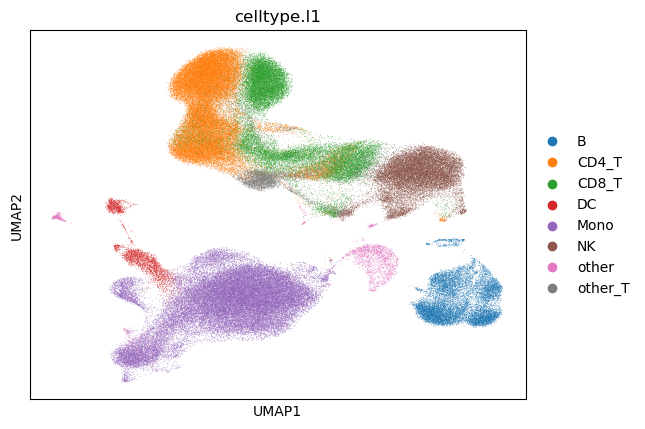

In [7]:
# UMAP embedding in adata
sc.pl.umap(adata, color=['celltype.l1'], legend_loc="right margin")

## B

In [8]:
annot[(annot['Cluster']=='B')]

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,B,B cell,3.598612e-56,1.428824e-54,7.807473e-07,11/169,12/264,"[CD79A, MS4A1, IGKC, BANK1, IGLC2, RALGPS2, CD...","[CD79A, MS4A1, IGKC, BANK1, IGLC2, RALGPS2, CD...","[PTPRC, B2M, MALAT1, BANK1, IGKC, IGLC2, CD79A..."
2,B,Plasma cell,4.722135e-31,8.865780e-34,5.742145e-02,7/64,7/333,"[CD79A, MS4A1, IGKC, IGLC2, CD79B, IGHM, PTPRC]","[CD79A, IGKC, IGLC2, CD79B, CD74, IGHM, B2M]","[PTPRC, CD74, B2M, MS4A1, IGKC, CD79B, IGHM, I..."
3,B,Granulocyte,7.493112e-26,9.689368e-28,NaN,10/69,2/40,"[CD79A, MS4A1, IGKC, BANK1, IGLC2, CD79B, CD74...","[HLA-DRA, FTH1]","[HLA-DRA, PTPRC, CD74, FTH1, MS4A1, BANK1, IGK..."
4,B,Memory B cell,8.672851e-20,1.137160e-22,3.119369e-01,6/39,8/44,"[MS4A1, BANK1, CD74, IGHM, HLA-DRA, S100A4]","[CD79A, MS4A1, IGKC, BANK1, RALGPS2, CD74, IGH...","[HLA-DRA, CD74, MS4A1, S100A4, RALGPS2, BANK1,..."
5,B,Pro-B cell,1.803002e-15,1.947465e-18,5.653710e-01,6/17,5/73,"[CD79A, MS4A1, CD79B, CD74, IGHM, HLA-DRA]","[CD79A, CD79B, CD74, IGHM, HLA-DRA]","[HLA-DRA, CD74, MS4A1, CD79B, IGHM, CD79A]"
6,B,Naive B cell,2.887010e-13,5.066515e-16,4.648649e-01,2/22,8/66,"[MS4A1, IGHM]","[CD79A, MS4A1, IGKC, BANK1, CD79B, CD74, IGHM,...","[HLA-DRA, CD74, MS4A1, BANK1, IGKC, CD79B, IGH..."
7,B,Immature B cell,3.946254e-13,7.355853e-15,5.064655e-02,2/5,8/119,"[CD79A, MS4A1]","[CD79A, MS4A1, BANK1, RALGPS2, CD79B, CD74, IG...","[HLA-DRA, CD74, MS4A1, RALGPS2, BANK1, CD79B, ..."
8,B,Plasmacytoid dendritic cell,2.888271e-11,1.120450e-12,NaN,7/93,5/295,"[CD79A, MS4A1, IGKC, IGLC2, CD74, HLA-DRA, PTPRC]","[IGKC, CD74, IGHM, HLA-DRA, MYL12A]","[MYL12A, HLA-DRA, PTPRC, CD74, MS4A1, IGKC, IG..."
9,B,Macrophage,7.836084e-10,5.645901e-12,2.320329e-01,6/281,9/653,"[CD74, HLA-DRA, B2M, PTPRC, FTH1, S100A4]","[CD74, HLA-DRA, TMSB4X, B2M, PTPRC, FTH1, ACTB...","[HLA-DRA, PTPRC, CD74, FTH1, B2M, S100A4, TMSB..."


In [9]:
B_canon = annot[(annot['Cluster']=='B') & (annot['Cell.Type']=='B cell')]['canonical.marker.overlap'].tolist()[0]
B_canon

['CD79A',
 'MS4A1',
 'IGKC',
 'BANK1',
 'IGLC2',
 'RALGPS2',
 'CD79B',
 'CD74',
 'IGHM',
 'HLA-DRA',
 'PTPRC']

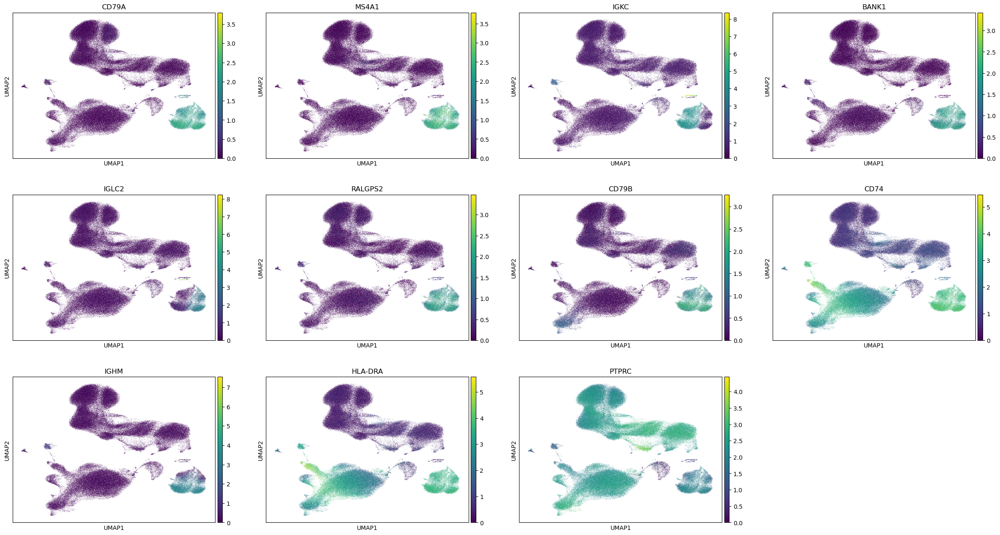

In [10]:
sc.pl.umap(adata, color=B_canon)

## CD4 T

In [11]:
annot[annot['Cluster']=='CD4_T']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,CD4_T,"Central memory CD4-positive, alpha-beta T cell",3.174219e-37,1.350731e-38,NaN,8/25,0/1,"[CD4, IL7R, TRAC, TMSB10, IL32, ITGB1, LTB, MAL]",,"[ITGB1, TMSB10, LTB, MAL, IL32, IL7R, TRAC, CD4]"
2,CD4_T,"CD4-positive, alpha-beta T cell",2.306728e-32,1.283803e-29,0.000001,7/93,24/281,"[CD4, CD40LG, CD2, TRBC1, IL7R, TRAC, LTB]","[CD4, TRAT1, CD40LG, CD52, ITM2A, CD2, TRBC1, ...","[CD40LG, CD2, FYB1, CD3D, S100A4, TRBC2, CD3G,..."
3,CD4_T,Helper T cell,2.480251e-29,1.520886e-30,0.018850,6/57,21/159,"[CD4, CD40LG, CD52, IL7R, IL32, TRBC2]","[CD4, TRAT1, CD40LG, CD52, ITM2A, CD2, TRBC1, ...","[CD40LG, FYB1, CD2, CD3D, CORO1B, S100A4, TRBC..."
4,CD4_T,Regulatory T cell,1.039378e-25,4.195768e-26,0.004058,8/68,10/98,"[CD4, CD40LG, CD52, TRBC1, IL7R, TRAC, IL32, T...","[CD2, TRBC1, TRAC, IL32, TRBC2, LTB, CORO1B, F...","[TRBC2, CD40LG, CD2, FYB1, CD3D, TRBC1, LTB, S..."
5,CD4_T,"Effector memory CD4-positive, alpha-beta T cell",8.134326e-24,1.038425e-24,NaN,5/26,0/1,"[CD4, IL7R, ITGB1, RORA, MAL]",,"[ITGB1, MAL, IL7R, RORA, CD4]"
6,CD4_T,"Activated CD4-positive, alpha-beta T cell",2.263805e-21,9.519732e-20,0.000065,4/30,19/430,"[CD4, IL7R, ITGB1, LTB]","[TRAT1, CD40LG, CD52, ITM2A, CD2, IL7R, TRAC, ...","[CD40LG, FYB1, CD2, CD3D, S100A4, TRBC2, CD3G,..."
7,CD4_T,"CD8-positive, alpha-beta T cell",1.003406e-17,2.936460e-14,0.000001,8/96,14/293,"[CD4, CD2, TRBC1, IL7R, TRAC, ITGB1, TRBC2, LTB]","[CD52, ITM2A, CD2, TRBC1, IL7R, TRAC, IL32, CD...","[CD2, CD3D, S100A4, TRBC2, CD3G, CD4, ITGB1, R..."
8,CD4_T,T-helper 17 cell,2.423728e-17,4.641182e-18,NaN,3/31,0/1,"[CD4, IL7R, RORA]",,"[RORA, IL7R, CD4]"
9,CD4_T,Induced T-regulatory cell,5.411617e-17,1.151408e-17,NaN,2/4,0/1,"[CD4, IL7R]",,"[IL7R, CD4]"


['CD4', 'IL7R', 'TRAC', 'TMSB10', 'IL32', 'ITGB1', 'LTB', 'MAL']


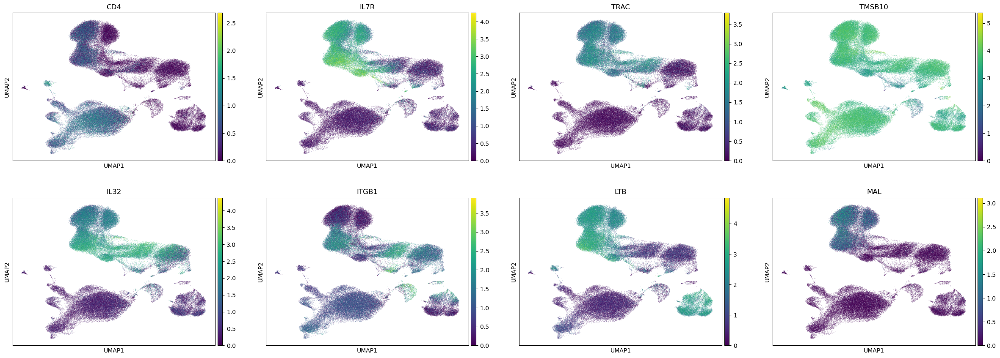

In [13]:
cd4_T_canon = annot[(annot['Cluster']=='CD4_T') & (annot['Cell.Type']=='Central memory CD4-positive, alpha-beta T cell')]['canonical.marker.overlap'].tolist()[0]
print(cd4_T_canon)
sc.pl.umap(adata, color=cd4_T_canon)

['CD4', 'CD40LG', 'CD2', 'TRBC1', 'IL7R', 'TRAC', 'LTB']


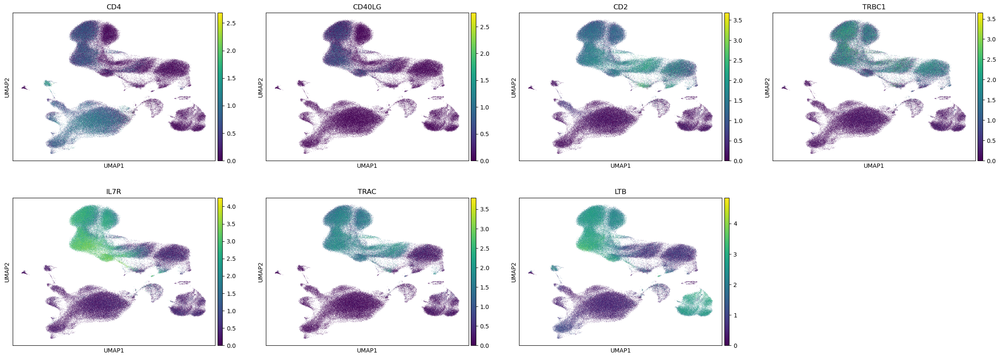

In [12]:
cd4_T_canon = annot[(annot['Cluster']=='CD4_T') & (annot['Cell.Type']=='CD4-positive, alpha-beta T cell')]['canonical.marker.overlap'].tolist()[0]
print(cd4_T_canon)
sc.pl.umap(adata, color=cd4_T_canon)

## CD8 T

In [14]:
annot[annot['Cluster']=='CD8_T']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,CD8_T,"Effector memory CD8-positive, alpha-beta T cell",6.048905e-40,6.274340e-41,0.004142,7/44,5/78,"[CD8B, CD8A, TRAC, CCL5, KLRB1, TMSB4X, CD74]","[CD8B, CD8A, CCL5, B2M, S100A4]","[CCL5, CD8A, KLRB1, CD74, CD8B, B2M, S100A4, T..."
2,CD8_T,"CD8-positive, alpha-beta T cell",9.461052e-40,1.108993e-37,0.000006,7/96,15/293,"[CD8B, CD8A, TRAC, CCL5, TRBC2, KLRB1, LTB]","[CD8B, CD8A, CD3D, TRAC, CD3G, CCL5, CD3E, TRB...","[CD3E, CD3D, CD8B, B2M, S100A4, TRBC2, CD3G, T..."
3,CD8_T,Mature NK T cell,1.559050e-24,1.402189e-25,0.015161,5/39,11/141,"[CD8B, CD8A, CCL5, IL32, KLRB1]","[CD3D, TRAC, CD3G, CCL5, CD3E, TRBC2, IL32, KL...","[CD3E, CD3D, CD8B, TRBC2, CD3G, CCL5, CD8A, KL..."
4,CD8_T,"CD8-positive, alpha-beta cytotoxic T cell",3.368848e-23,8.399197e-24,0.007224,3/51,14/175,"[CD8B, CD8A, CCL5]","[CD8B, CD8A, CD3D, TRAC, CD3G, CCL5, CD3E, TRB...","[CD3E, CD3D, CD8B, B2M, TRBC2, CD3G, CCL5, CD8..."
5,CD8_T,"Naive thymus-derived CD8-positive, alpha-beta ...",2.168688e-21,2.495466e-23,0.203046,2/13,13/179,"[CD8B, CD8A]","[CD8B, CD8A, CD3D, CD3G, CCL5, CD3E, TRBC2, IL...","[CCL5, CD8A, CD3E, CD3D, ARL4C, CD8B, MT-CO1, ..."
6,CD8_T,"Central memory CD8-positive, alpha-beta T cell",3.232928e-18,3.227966e-19,0.036355,2/9,5/40,"[CD8B, CD8A]","[CD8B, CD8A, CCL5, B2M, CD74]","[CCL5, CD8A, CD74, CD8B, B2M]"
7,CD8_T,"Double-positive, alpha-beta thymocyte",5.997754e-18,1.148506e-18,NaN,2/5,0/1,"[CD8B, CD8A]",,"[CD8A, CD8B]"
8,CD8_T,"CD4-positive, alpha-beta T cell",2.875365e-14,1.230678e-13,0.001331,7/93,11/281,"[CD8B, CD8A, TRAC, CCL5, FTH1, KLRB1, LTB]","[CD3D, TRAC, CD3G, CCL5, CD3E, TRBC2, IL32, KL...","[CD3E, CD3D, FTH1, CD8B, S100A4, TRBC2, CD3G, ..."
9,CD8_T,"Effector CD8-positive, alpha-beta T cell",8.065477e-14,1.887665e-14,NaN,2/8,0/1,"[CD8B, CD8A]",,"[CD8A, CD8B]"


['CD8B', 'CD8A', 'TRAC', 'CCL5', 'KLRB1', 'TMSB4X', 'CD74']


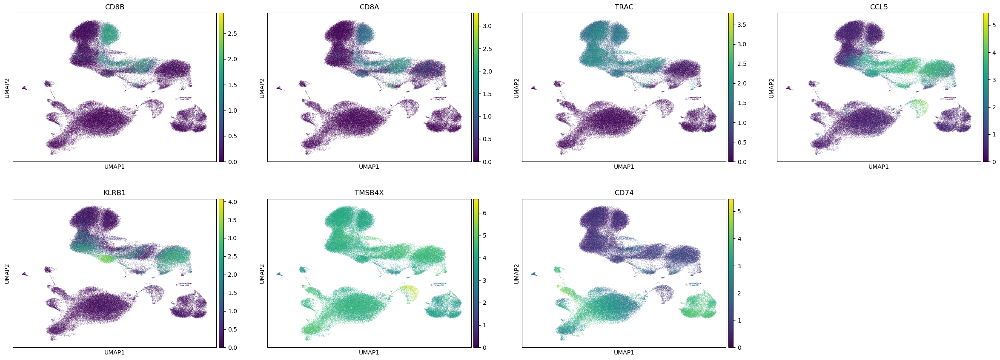

In [15]:
name = 'Effector memory CD8-positive, alpha-beta T cell'
CD8_Tem_canon = annot[(annot['Cluster']=='CD8_T') & (annot['Cell.Type']==name)]['canonical.marker.overlap'].tolist()[0]
print(CD8_Tem_canon)
sc.pl.umap(adata, color=CD8_Tem_canon)

['CD8B', 'CD8A', 'TRAC', 'CCL5', 'TRBC2', 'KLRB1', 'LTB']


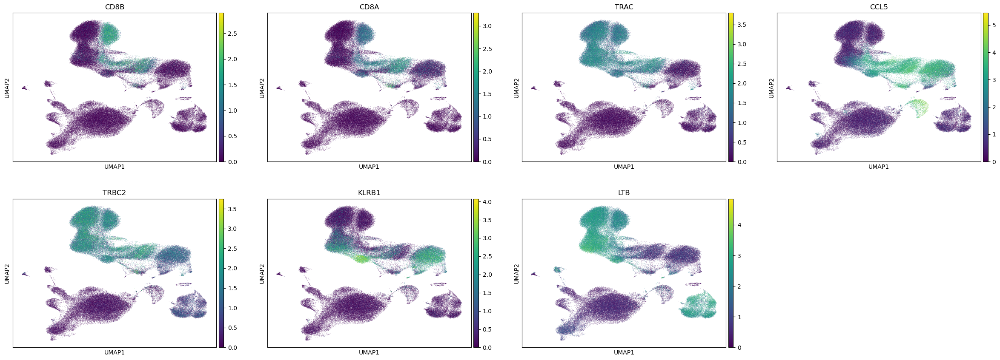

In [16]:
name = 'CD8-positive, alpha-beta T cell'
CD8_abT_canon = annot[(annot['Cluster']=='CD8_T') & (annot['Cell.Type']==name)]['canonical.marker.overlap'].tolist()[0]
print(CD8_abT_canon)
sc.pl.umap(adata, color=CD8_abT_canon)

## DC

In [17]:
annot[annot['Cluster']=='DC']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,DC,CD1c-positive myeloid dendritic cell,2.352204e-22,1.554442e-25,0.248120,4/15,8/35,"[CST3, FCER1A, CLEC10A, HLA-DRA]","[CST3, FCER1A, HLA-DQA1, HLA-DPB1, CLEC10A, HL...","[CLEC10A, HLA-DRA, HLA-DPB1, HLA-DPA1, CD74, C..."
2,DC,"Dendritic cell, human",2.352204e-22,3.041643e-24,NaN,2/6,0/1,"[FCER1A, CLEC10A]",,"[CLEC10A, FCER1A]"
3,DC,Conventional dendritic cell,2.541558e-22,9.201030e-25,0.080913,7/22,10/99,"[CST3, FCER1A, HLA-DPB1, CLEC10A, HLA-DRA, IRF...","[CST3, HLA-DQA1, HLA-DPB1, CLEC10A, HLA-DPA1, ...","[CTSS, HLA-DQB1, FCER1A, CLEC10A, HLA-DRA, HLA..."
4,DC,Monocyte,8.720346e-21,8.914844e-23,0.038306,14/218,18/365,"[CST3, HLA-DQA1, HLA-DPB1, CLEC10A, HLA-DPA1, ...","[CST3, HLA-DQA1, HLA-DPB1, ARL4C, SAMHD1, HLA-...","[NEAT1, FTL, PTPRE, TXN, CLEC10A, CD74, CST3, ..."
5,DC,Myeloid dendritic cell,6.323500e-20,1.635388e-21,NaN,10/63,0/1,"[CST3, FCER1A, HLA-DQA1, PLD4, HLA-DPB1, CLEC1...",,"[CLEC10A, HLA-DRA, HLA-DPB1, PLD4, HLA-DPA1, H..."
6,DC,Plasmacytoid dendritic cell,3.336927e-19,1.870731e-20,0.010558,9/93,18/295,"[CST3, FCER1A, PLD4, CCDC50, HLA-DPA1, HLA-DRA...","[HLA-DQA1, PPP1R14B, CCDC88A, PLD4, HLA-DPB1, ...","[PLD4, JAML, PTPRE, HLA-DQB1, FCER1A, CCDC88A,..."
7,DC,Type 2 conventional dendritic cell,3.993983e-18,2.522138e-19,0.011304,2/22,14/184,"[FCER1A, CLEC10A]","[CST3, FCER1A, HLA-DQA1, HLA-DPB1, CLEC10A, SA...","[CTSS, FTL, PTPRE, JAML, HLA-DQB1, FCER1A, CLE..."
8,DC,Macrophage,1.720396e-16,2.954906e-17,0.005094,12/281,23/653,"[CST3, HLA-DQA1, HLA-DPB1, HLA-DPA1, HLA-DRA, ...","[CST3, FCER1A, HLA-DQA1, CCDC88A, PLD4, HLA-DP...","[NEAT1, FTL, PTPRE, CLEC10A, IRF8, CD74, CST3,..."
9,DC,B cell,1.963804e-13,1.700609e-12,0.000148,9/169,15/264,"[CST3, HLA-DQA1, HLA-DPB1, HLA-DPA1, HLA-DRA, ...","[HLA-DQA1, HLA-DPB1, HERPUD1, CCDC50, HLA-DPA1...","[CTSS, NEAT1, HLA-DQB1, HLA-E, KLF2, MALAT1, H..."


['CST3', 'FCER1A', 'CLEC10A', 'HLA-DRA']


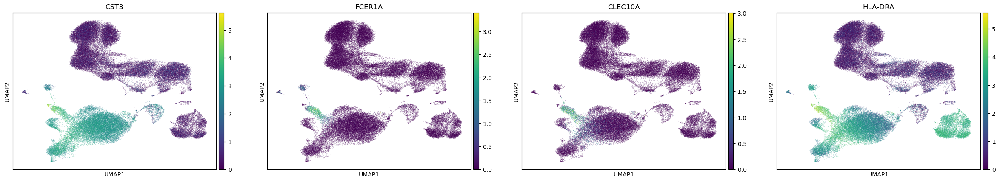

In [19]:
DC_canon = annot[(annot['Cluster']=='DC') & (annot['Cell.Type']=='CD1c-positive myeloid dendritic cell')]['canonical.marker.overlap'].tolist()[0]
print(DC_canon)
sc.pl.umap(adata, color=DC_canon)

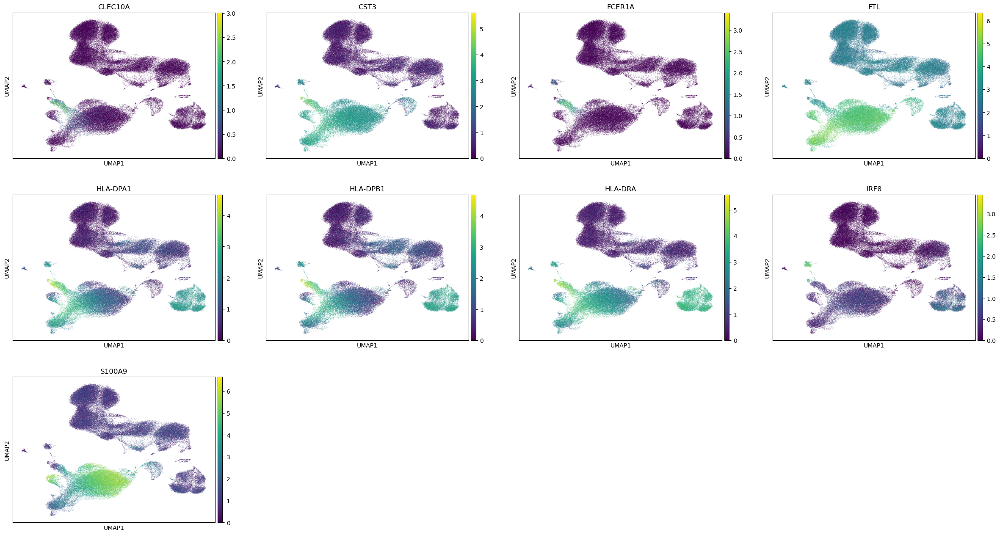

In [20]:
# 沒啥幫助
dendritic_all = ['CLEC10A',
 'CST3',
 'FCER1A',
 'FTL',
 'HLA-DPA1',
 'HLA-DPB1',
 'HLA-DRA',
 'IRF8',
 'S100A9']  # intersection between PreLect and all "Dendritic cell" markers in ACT
sc.pl.umap(adata, color=dendritic_all)

## Monocyte

In [21]:
annot[annot['Cluster']=='Mono']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Mono,Monocyte,9.240802e-61,8.072550e-59,3.296249e-07,19/218,23/365,"[CTSS, NEAT1, PSAP, CFD, S100A8, AIF1, SERPINA...","[CTSS, NEAT1, PSAP, CFD, S100A8, AIF1, SERPINA...","[NEAT1, FTL, FCN1, NFKBIA, PSAP, S100A9, TAGLN..."
2,Mono,Macrophage,7.331169e-34,1.523505e-36,4.795205e-02,19/281,23/653,"[CTSS, NEAT1, PSAP, S100A8, AIF1, SERPINA1, FT...","[CTSS, NEAT1, PSAP, CFD, S100A8, AIF1, SERPINA...","[MT-ATP6, NEAT1, FTL, FCN1, NFKBIA, B2M, PSAP,..."
3,Mono,CD14-positive monocyte,2.626815e-25,8.094975e-28,6.344411e-02,4/25,16/155,"[S100A8, FCN1, CD14, S100A9]","[CTSS, NEAT1, PSAP, S100A8, AIF1, SERPINA1, FT...","[CTSS, NEAT1, FTL, FCN1, SERPINA1, NFKBIA, CCL..."
4,Mono,Classical monocyte,1.413780e-19,6.141621e-22,7.570978e-02,6/122,10/66,"[NEAT1, S100A8, FCN1, CD14, S100A9, SOD2]","[CTSS, S100A8, SERPINA1, CYBB, FCN1, CD14, S10...","[CTSS, NEAT1, FCN1, SERPINA1, CCL3, MARCKS, S1..."
5,Mono,Myelocyte,9.791971e-19,2.532406e-20,NaN,2/8,0/1,"[S100A8, FTL]",,"[S100A8, FTL]"
6,Mono,Dendritic cell,6.926147e-15,1.669191e-16,3.517588e-02,9/143,19/307,"[AIF1, SERPINA1, FTL, LST1, FCN1, CD14, S100A9...","[CTSS, NEAT1, PSAP, AIF1, SERPINA1, FTL, LST1,...","[CTSS, NEAT1, FTL, SERPINA1, FCN1, NFKBIA, CCL..."
7,Mono,Suppressor macrophage,6.926147e-15,2.138624e-16,NaN,3/16,0/1,"[S100A8, CD14, S100A9]",,"[S100A8, S100A9, CD14]"
8,Mono,T cell,4.497989e-14,1.744909e-15,NaN,12/224,6/225,"[PSAP, S100A8, AIF1, FTL, CYBB, LST1, FCN1, S1...","[AIF1, B2M, MYL12A, RPS18, RPS27, RPS29]","[MYL12A, FTL, FCN1, DUSP1, RPS18, CCL3, RPS27,..."
9,Mono,Neutrophil,4.787471e-13,1.650347e-15,3.463855e-01,4/117,14/280,"[S100A8, CD14, S100A9, CCL3]","[CTSS, S100A8, AIF1, SERPINA1, CYBB, LST1, FCN...","[CTSS, SERPINA1, FCN1, RPS18, CCL3, S100A9, LS..."


['CTSS', 'NEAT1', 'PSAP', 'CFD', 'S100A8', 'AIF1', 'SERPINA1', 'FTL', 'CYBB', 'LST1', 'FCN1', 'CD14', 'SAT1', 'S100A9', 'TYMP', 'NFKBIA', 'SOD2', 'HLA-DPB1', 'MALAT1']


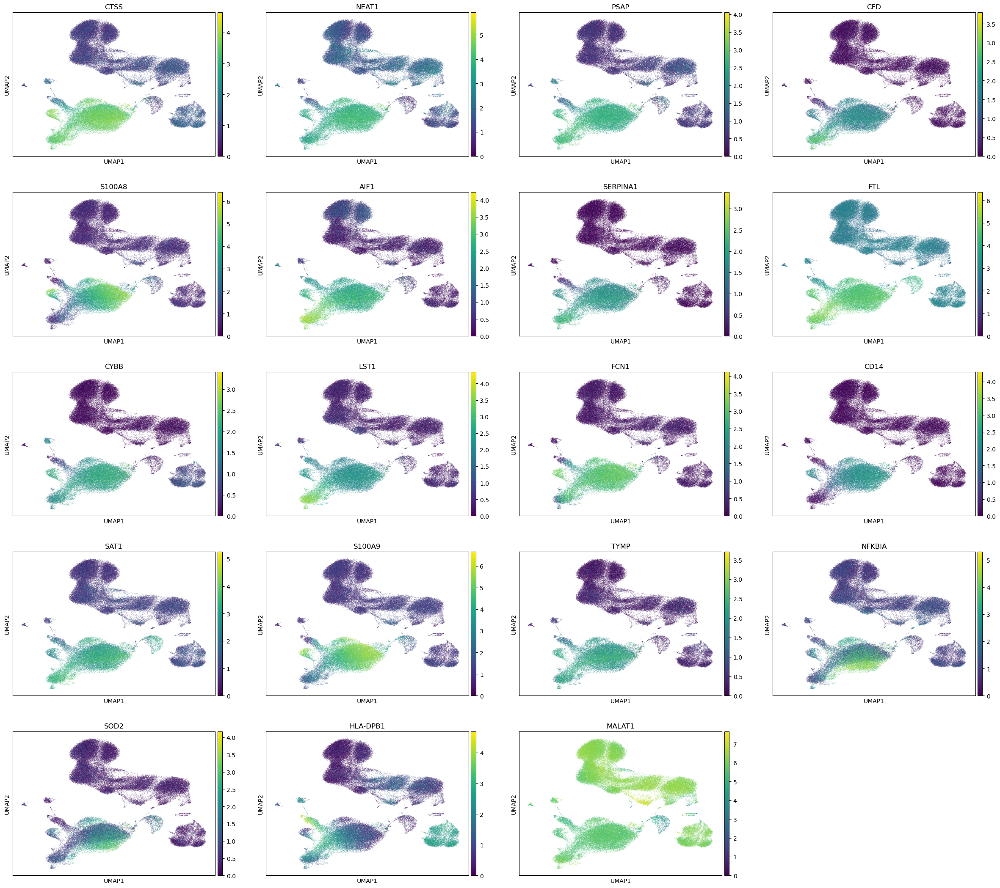

In [22]:
mono_canon = annot[(annot['Cluster']=='Mono') & (annot['Cell.Type']=='Monocyte')]['canonical.marker.overlap'].tolist()[0]
print(mono_canon)
sc.pl.umap(adata, color=mono_canon)

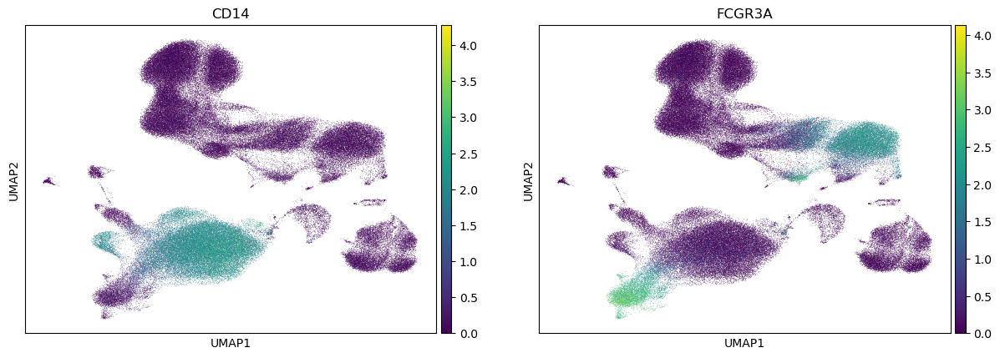

In [23]:
sc.pl.umap(adata, color=['CD14', 'FCGR3A'])
# FCGR3A is CD16

## NK

In [24]:
annot[annot['Cluster']=='NK']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,NK,Natural killer cell,6.227145e-70,1.512539e-67,1.038127e-07,15/150,22/223,"[KLRF1, GNLY, CD247, FCER1G, TYROBP, CD7, SPON...","[KLRF1, GNLY, CD247, FCER1G, TYROBP, CD7, SPON...","[JAK1, S100A4, FCER1G, PRF1, CD247, GNLY, SPON..."
2,NK,Mature NK T cell,3.848528e-65,3.944778e-67,5.284751e-03,12/42,15/141,"[KLRF1, GNLY, FCER1G, TYROBP, CD7, KLRD1, PRF1...","[GNLY, CD247, CD7, KLRD1, IL2RB, PRF1, NKG7, K...","[TYROBP, MALAT1, FCER1G, CD7, IL2RB, PRF1, CD2..."
3,NK,Circulating natural killer cell,3.856514e-31,1.234084e-32,5.066548e-03,5/12,14/87,"[GNLY, TYROBP, KLRD1, NKG7, GZMB]","[KLRF1, GNLY, FCER1G, TYROBP, CD7, SPON2, KLRD...","[TYROBP, FCER1G, CD7, IL2RB, PRF1, GNLY, HOPX,..."
4,NK,"Effector memory CD8-positive, alpha-beta T cel...",1.887482e-30,1.685674e-33,2.479592e-01,6/14,14/167,"[GNLY, KLRD1, PRF1, NKG7, GZMB, HOPX]","[KLRF1, GNLY, TYROBP, KLRD1, PRF1, NKG7, KLRB1...","[TYROBP, B2M, RPS12, TMSB4X, PRF1, GNLY, KLRB1..."
5,NK,"CD8-positive, alpha-beta cytotoxic T cell",3.533579e-30,1.704228e-31,5.803625e-03,5/54,17/175,"[GNLY, CD7, PRF1, NKG7, GZMB]","[KLRF1, GNLY, CD247, CD7, KLRD1, PRF1, NKG7, K...","[JAK1, MALAT1, B2M, RPS12, CD7, PRF1, CD247, G..."
6,NK,T cell,7.587612e-22,8.116418e-24,4.216867e-02,15/224,17/225,"[KLRF1, GNLY, CD247, CD7, KLRD1, IL2RB, PRF1, ...","[GNLY, CD247, CD7, KLRD1, IL2RB, PRF1, NKG7, K...","[FTL, B2M, S100A4, RPS12, PRF1, CD247, GNLY, C..."
7,NK,"Effector memory CD8-positive, alpha-beta T cell",2.369812e-16,3.277445e-18,4.928131e-02,6/47,12/78,"[GNLY, KLRD1, PRF1, NKG7, KLRB1, TMSB4X]","[GNLY, SPON2, KLRD1, PRF1, NKG7, CTSW, GZMB, C...","[S100A6, B2M, S100A4, RPS12, TMSB4X, PRF1, GNL..."
8,NK,"CD16-negative, CD56-bright natural killer cell...",5.221717e-14,1.365660e-13,3.415389e-04,2/4,19/554,"[GNLY, NKG7]","[KLRF1, GNLY, CD247, FCER1G, SPON2, PRF1, NKG7...","[MT-ND2, S100A6, B2M, MALAT1, S100A4, FCER1G, ..."
9,NK,CD16-negative natural killer cell,2.574035e-13,1.220448e-14,NaN,2/3,0/1,"[GNLY, NKG7]",,"[NKG7, GNLY]"


['KLRF1', 'GNLY', 'CD247', 'FCER1G', 'TYROBP', 'CD7', 'SPON2', 'KLRD1', 'IL2RB', 'PRF1', 'NKG7', 'KLRB1', 'CTSW', 'GZMB', 'IL32']


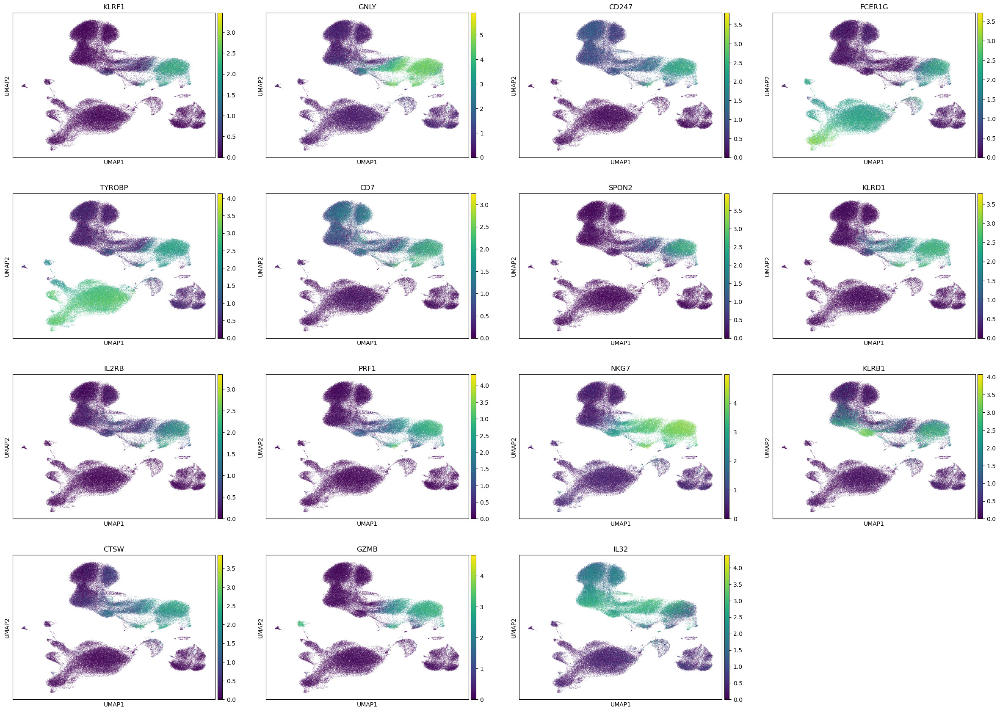

In [25]:
NK_canon = annot[(annot['Cluster']=='NK') & (annot['Cell.Type']=='Natural killer cell')]['canonical.marker.overlap'].tolist()[0]
print(NK_canon)
sc.pl.umap(adata, color=NK_canon)

## other

In [26]:
annot[annot['Cluster']=='other']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,other,Megakaryocyte,5.520320e-22,2.379448e-24,NaN,3/69,3/53,"[PPBP, NRGN, PF4]","[PPBP, NRGN, PF4]","[PPBP, PF4, NRGN]"
2,other,Platelet,1.885891e-16,1.625768e-18,NaN,2/53,3/114,"[PPBP, PF4]","[PPBP, NRGN, PF4]","[PPBP, NRGN, PF4]"
3,other,Megakaryocyte progenitor cell,9.694181e-15,1.253558e-16,NaN,2/15,3/94,"[PPBP, PF4]","[PPBP, NRGN, PF4]","[PPBP, NRGN, PF4]"


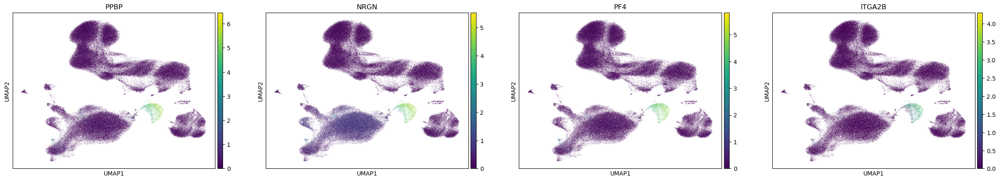

In [29]:
sc.pl.umap(adata, color=['PPBP', 'NRGN', 'PF4', 'ITGA2B'])
# Platelets marker: 'ITGA2B'

In [ ]:
# Platelets marker: 'ITGA2B'
# Erythrocytes marker: 'GYPA', 'HBB'
# ILC marker: 'CD127' (IL7R)
# HSPC (Hematopoietic Stem and Progenitor Cells) marker: 'CD34'
sc.pl.umap(adata, color=['ITGA2B', 'GYPA', 'HBB', 'IL7R', 'CD34'])

## other_T

In [30]:
annot[annot['Cluster']=='other_T']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,other_T,Mucosal invariant T cell,2.530812e-25,3.245472e-25,0.000253,5/17,13/81,"[NCR3, KLRB1, SLC4A10, CXCR4, IL7R]","[TRGC1, GZMK, NCR3, KLRB1, PHACTR2, SLC4A10, S...","[S100A6, DUSP2, SPOCK2, LYAR, KLRG1, KLRB1, NC..."
2,other_T,Gamma-delta T cell,3.216914e-25,2.029457e-25,0.001042,5/35,24/308,"[TRDC, TRGC1, TRGC2, NKG7, IL7R]","[TRDC, CD3D, TRGC1, IKZF2, GZMK, CD3G, TRGC2, ...","[SYNE2, CD3E, TRGC2, CD3D, DUSP2, TRDC, SPOCK2..."
3,other_T,"Effector memory CD8-positive, alpha-beta T cell",3.546580e-24,2.263774e-25,NaN,6/44,4/78,"[GZMK, TRGC2, KLRB1, NKG7, CXCR4, IL7R]","[GZMK, S100A6, NKG7, IL7R]","[KLRB1, TRGC2, GZMK, S100A6, CXCR4, IL7R, NKG7]"
4,other_T,Mature NK T cell,2.573743e-21,1.103190e-22,0.036181,7/39,16/141,"[TRDC, TRGC1, TRGC2, NCR3, KLRB1, NKG7, IL7R]","[TRDC, CD3D, GZMK, CD3G, NCR3, KLRB1, KLRG1, L...","[CD3E, TRGC2, CD3D, DUSP2, TRDC, SPOCK2, HCST,..."
5,other_T,T cell,6.300981e-19,4.904345e-20,0.027870,11/221,20/225,"[TRDC, TRGC1, GZMK, NCR3, KLRB1, MT2A, SLC4A10...","[TRDC, CD3D, GZMK, CD3G, TRGC2, KLRB1, KLRG1, ...","[CD3E, TRGC2, CD3D, DUSP2, TRDC, SPOCK2, HCST,..."
6,other_T,"Effector memory CD4-positive, alpha-beta T cell",1.451011e-17,1.852355e-18,NaN,4/26,0/1,"[GZMK, KLRB1, CXCR4, IL7R]",,"[KLRB1, CXCR4, GZMK, IL7R]"
7,other_T,"CD8-positive, alpha-beta cytotoxic T cell",1.790657e-16,1.747973e-16,0.003555,5/51,18/175,"[TRDC, TRGC1, GZMK, TRGC2, NKG7]","[TRDC, CD3D, TRGC1, GZMK, CD3G, TRGC2, KLRB1, ...","[SYNE2, CD3E, TRGC2, CD3D, DUSP2, TRDC, SPOCK2..."
8,other_T,"Effector CD4-positive, alpha-beta T cell",2.247499e-15,1.350065e-16,0.070499,3/7,8/89,"[GZMK, KLRB1, NKG7]","[GZMK, NCR3, KLRB1, S100A6, KLRG1, NKG7, HCST,...","[KLRB1, NCR3, SYNE2, GZMK, S100A6, HCST, NKG7,..."
9,other_T,"CD8-positive, alpha-beta T cell",4.042482e-14,3.941497e-13,0.000529,7/96,19/293,"[IKZF2, GZMK, KLRB1, KLRG1, NKG7, DUSP2, IL7R]","[TRDC, CD3D, TRGC1, GZMK, CD3G, TRGC2, NCR3, K...","[SYNE2, CD3E, TRGC2, CD3D, DUSP2, TRDC, SPOCK2..."


In [31]:
adata.obs[adata.obs['celltype.l1']=='other_T']['celltype.l2'].unique()

['MAIT', 'gdT', 'dnT']
Categories (31, object): ['ASDC', 'B intermediate', 'B memory', 'B naive', ..., 'cDC2', 'dnT', 'gdT', 'pDC']

['NCR3', 'KLRB1', 'SLC4A10', 'CXCR4', 'IL7R']


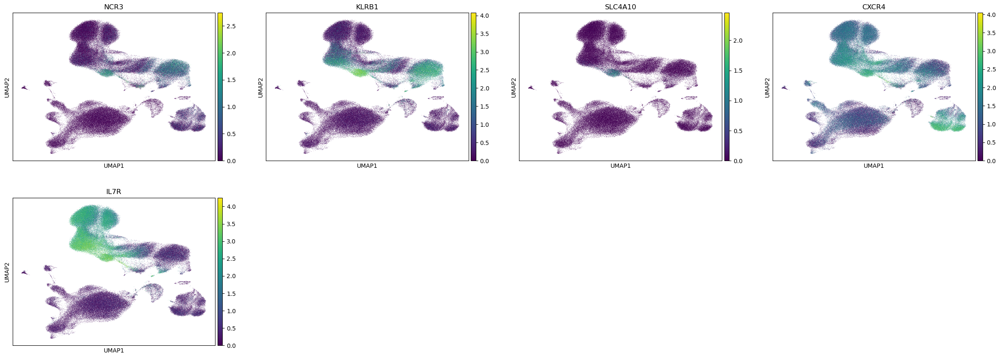

In [33]:
MAIT_canon = annot[(annot['Cluster']=='other_T') & (annot['Cell.Type']=='Mucosal invariant T cell')]['canonical.marker.overlap'].tolist()[0]
print(MAIT_canon)
sc.pl.umap(adata, color=MAIT_canon)

['TRDC', 'TRGC1', 'TRGC2', 'NKG7', 'IL7R']


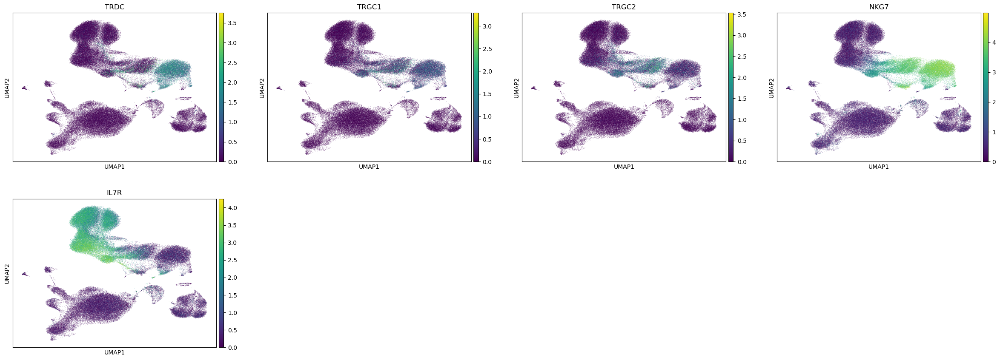

In [34]:
gdT_canon = annot[(annot['Cluster']=='other_T') & (annot['Cell.Type']=='Gamma-delta T cell')]['canonical.marker.overlap'].tolist()[0]
print(gdT_canon)
sc.pl.umap(adata, color=gdT_canon)